In [57]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/wm811k-wafer-map/LSWMD.pkl


In [58]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder , StandardScaler
from sklearn.model_selection import train_test_split

from sklearn.linear_model import Perceptron

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Flatten

from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Dropout

from tensorflow.keras.utils import to_categorical
import pickle
import os
import tensorflow as tf
from sklearn.metrics import ConfusionMatrixDisplay
import time


In [59]:
import sys
import pandas as pd
import pickle

# Fix for old pandas pickle compatibility
sys.modules['pandas.indexes'] = pd.core.indexes

with open('/kaggle/input/wm811k-wafer-map/LSWMD.pkl', 'rb') as f:
    data = pickle.load(f, encoding='latin1')

df = pd.DataFrame(data)
print(df.shape)


(811457, 6)


In [60]:
df.columns


Index(['waferMap', 'dieSize', 'lotName', 'waferIndex', 'trianTestLabel',
       'failureType'],
      dtype='object')

In [61]:
df.head()

,waferMap,dieSize,lotName,waferIndex,trianTestLabel,failureType
0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,1.0,[[Training]],[[none]]
1,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,2.0,[[Training]],[[none]]
2,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,3.0,[[Training]],[[none]]
3,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,4.0,[[Training]],[[none]]
4,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1683.0,lot1,5.0,[[Training]],[[none]]


In [62]:
df['failureType'].astype(str).value_counts().head(10)


failureType
[]                 638507
[['none']]         147431
[['Edge-Ring']]      9680
[['Edge-Loc']]       5189
[['Center']]         4294
[['Loc']]            3593
[['Scratch']]        1193
[['Random']]          866
[['Donut']]           555
[['Near-full']]       149
Name: count, dtype: int64

In [63]:
import numpy as np

def extract_label(x):
    # handle list OR numpy array
    if isinstance(x, (list, np.ndarray)) and len(x) > 0:
        first = x[0]
        if isinstance(first, (list, np.ndarray)) and len(first) > 0:
            return str(first[0])
    return 'none'


In [64]:
df['label'] = df['failureType'].apply(extract_label)


In [65]:
df['label'].value_counts()


label
none         785938
Edge-Ring      9680
Edge-Loc       5189
Center         4294
Loc            3593
Scratch        1193
Random          866
Donut           555
Near-full       149
Name: count, dtype: int64

In [66]:
df_defect = df[df['label'] != 'none'].reset_index(drop=True)
print(df_defect.shape)
df_defect['label'].value_counts()


(25519, 7)


label
Edge-Ring    9680
Edge-Loc     5189
Center       4294
Loc          3593
Scratch      1193
Random        866
Donut         555
Near-full     149
Name: count, dtype: int64

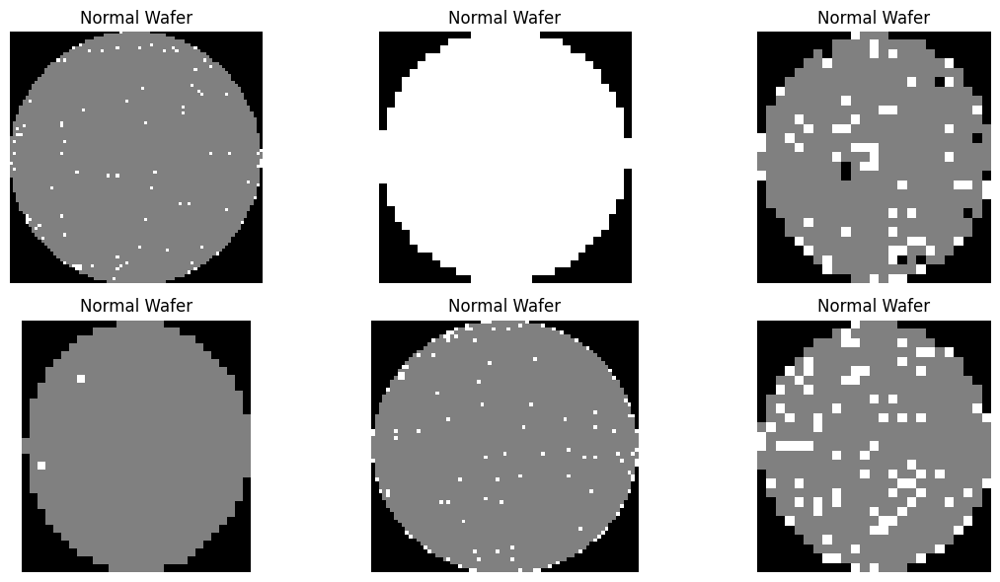

In [67]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12,6))

for i in range(6):
    idx = np.random.randint(len(df))
    plt.subplot(2,3,i+1)
    plt.imshow(df['waferMap'].iloc[idx], cmap='gray')
    plt.title("Normal Wafer")
    plt.axis('off')

plt.tight_layout()
plt.show()


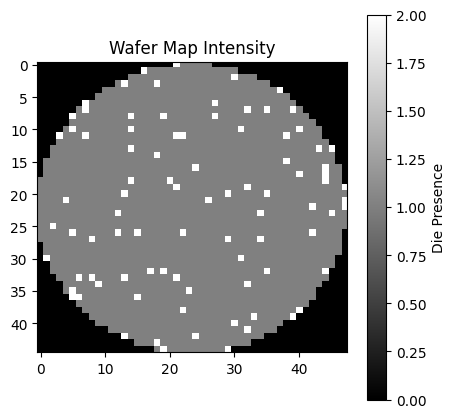

In [68]:
plt.figure(figsize=(5,5))
plt.imshow(df['waferMap'].iloc[0], cmap='gray')
plt.colorbar(label="Die Presence")
plt.title("Wafer Map Intensity")
plt.show()


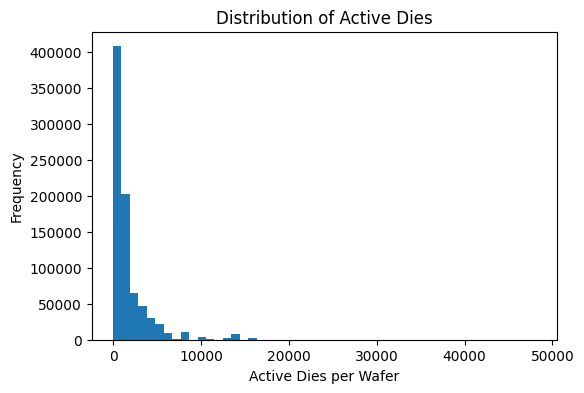

In [69]:
die_counts = df['waferMap'].apply(lambda x: np.sum(np.array(x) > 0))

plt.figure(figsize=(6,4))
plt.hist(die_counts, bins=50)
plt.xlabel("Active Dies per Wafer")
plt.ylabel("Frequency")
plt.title("Distribution of Active Dies")
plt.show()


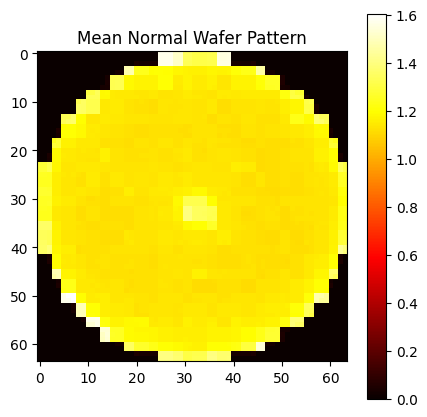

In [70]:
# Resize first for consistency
import cv2

def resize_wafer(w, size=64):
    return cv2.resize(np.array(w), (size, size), interpolation=cv2.INTER_NEAREST)

sample_maps = np.array([resize_wafer(w) for w in df['waferMap'][:5000]])
mean_map = np.mean(sample_maps, axis=0)

plt.figure(figsize=(5,5))
plt.imshow(mean_map, cmap='hot')
plt.title("Mean Normal Wafer Pattern")
plt.colorbar()
plt.show()


In [71]:
import cv2

def resize_wafer(w, size=64):
    return cv2.resize(
        np.array(w),
        (size, size),
        interpolation=cv2.INTER_NEAREST
    )

X = np.array([resize_wafer(w) for w in df_defect['waferMap']])
X = X[..., np.newaxis]
X = X / X.max()


In [72]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
y = le.fit_transform(df_defect['label'])

print("Classes:", le.classes_)


Classes: ['Center' 'Donut' 'Edge-Loc' 'Edge-Ring' 'Loc' 'Near-full' 'Random'
 'Scratch']


In [73]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)


In [74]:
X_train, X_val = train_test_split(
    X, test_size=0.1, random_state=42
)

print(X_train.shape, X_val.shape)

(22967, 64, 64, 1) (2552, 64, 64, 1)


In [75]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

model = Sequential([
    Conv2D(32, 3, activation='relu', input_shape=X.shape[1:]),
    MaxPooling2D(2),

    Conv2D(64, 3, activation='relu'),
    MaxPooling2D(2),

    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.4),

    Dense(len(le.classes_), activation='softmax')
])

model.compile(
    optimizer='adam',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 62, 62, 32)     │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 31, 31, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 29, 29, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 14, 14, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │     1,605,760 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 8)              │         1,032 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,625,608 (6.20 MB)

 Trainable params: 1,625,608 (6.20 MB)

 Non-trainable params: 0 (0.00 B)

In [76]:
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

assert X_train.shape[0] == y_train.shape[0]


X_train shape: (22967, 64, 64, 1)
y_train shape: (20415,)


AssertionError: 

In [77]:
print(df_defect.shape)


(25519, 7)


In [78]:
import numpy as np
import cv2
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

X = []
y = []

for _, row in df_defect.iterrows():
    wafer = cv2.resize(
        np.array(row['waferMap']),
        (64, 64),
        interpolation=cv2.INTER_NEAREST
    )
    X.append(wafer)
    y.append(row['label'])

X = np.array(X, dtype=np.float32)
X = X[..., np.newaxis]
X /= X.max()

le = LabelEncoder()
y = le.fit_transform(y)

print("X:", X.shape)
print("y:", y.shape)


X: (25519, 64, 64, 1)
y: (25519,)


In [79]:
X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

print("X_train:", X_train.shape)
print("y_train:", y_train.shape)


X_train: (20415, 64, 64, 1)
y_train: (20415,)


In [80]:
history = model.fit(
    X_train,
    y_train,
    epochs=10,
    batch_size=64
)


Epoch 1/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 53s 161ms/step - accuracy: 0.5707 - loss: 1.1545
Epoch 2/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 159ms/step - accuracy: 0.7909 - loss: 0.5641
Epoch 3/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 159ms/step - accuracy: 0.8332 - loss: 0.4435
Epoch 4/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 159ms/step - accuracy: 0.8488 - loss: 0.3981
Epoch 5/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 52s 161ms/step - accuracy: 0.8699 - loss: 0.3420
Epoch 6/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 50s 158ms/step - accuracy: 0.8888 - loss: 0.2956
Epoch 7/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 52s 162ms/step - accuracy: 0.9005 - loss: 0.2569
Epoch 8/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 159ms/step - accuracy: 0.9169 - loss: 0.2190
Epoch 9/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 159ms/step - accuracy: 0.9322 - loss: 0.1865
Epoch 10/10
319/319 ━━━━━━━━━━━━━━━━━━━━ 51s 158ms/step - accuracy: 0.9377 - loss: 0.1667


In [81]:
import numpy as np

y_pred = np.argmax(model.predict(X_test), axis=1)


160/160 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step


In [83]:
from sklearn.metrics import classification_report

print(
    classification_report(
        y_test,
        y_pred,
        target_names=le.classes_
    )
)


              precision    recall  f1-score   support

      Center       0.93      0.95      0.94       859
       Donut       0.76      0.86      0.81       111
    Edge-Loc       0.87      0.82      0.84      1038
   Edge-Ring       0.96      0.99      0.98      1936
         Loc       0.73      0.75      0.74       719
   Near-full       0.92      0.77      0.84        30
      Random       0.84      0.95      0.89       173
     Scratch       0.53      0.41      0.46       238

    accuracy                           0.88      5104
   macro avg       0.82      0.81      0.81      5104
weighted avg       0.88      0.88      0.88      5104



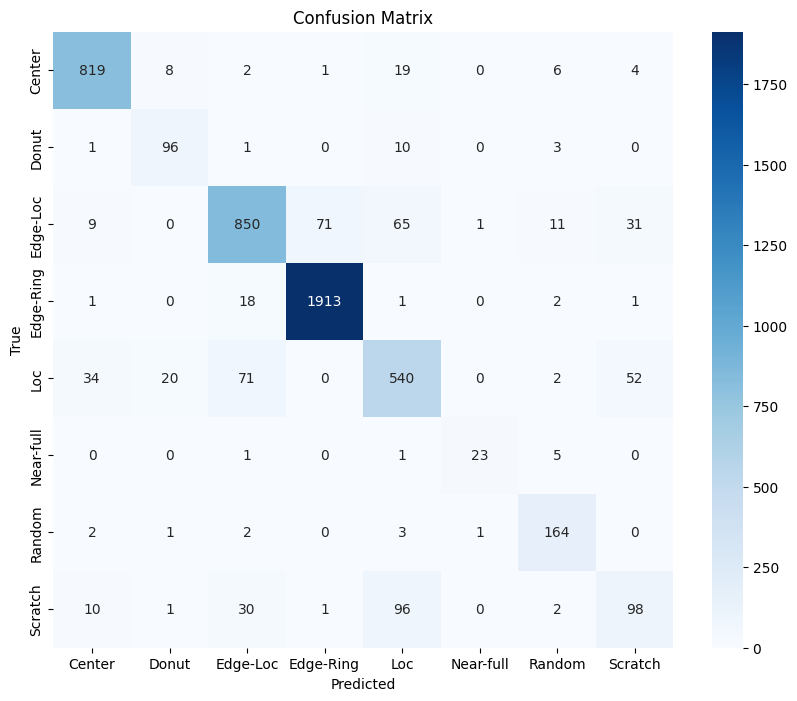

In [84]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10,8))
sns.heatmap(
    cm,
    annot=True,
    fmt="d",
    cmap="Blues",
    xticklabels=le.classes_,
    yticklabels=le.classes_
)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()


In [85]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print("Accuracy :", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred, average='weighted'))
print("Recall   :", recall_score(y_test, y_pred, average='weighted'))
print("F1-score :", f1_score(y_test, y_pred, average='weighted'))


Accuracy : 0.8822492163009404
Precision: 0.8785616610996161
Recall   : 0.8822492163009404
F1-score : 0.8795996251470456


In [86]:
model.save("wafer_model.h5")

import os
size_mb = os.path.getsize("wafer_model.h5") / (1024 * 1024)
print(f"Model size: {size_mb:.2f} MB")


Model size: 18.64 MB


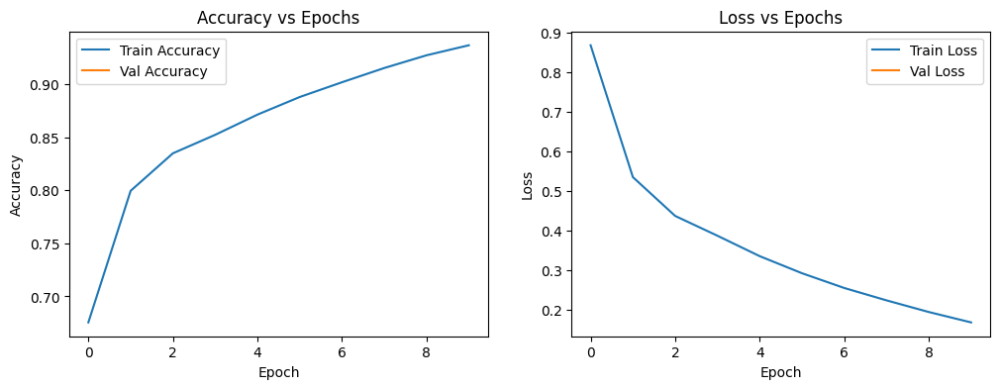

In [87]:
plt.figure(figsize=(12,4))

# Accuracy
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history.get('val_accuracy', []), label='Val Accuracy')
plt.title('Accuracy vs Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history.get('val_loss', []), label='Val Loss')
plt.title('Loss vs Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()


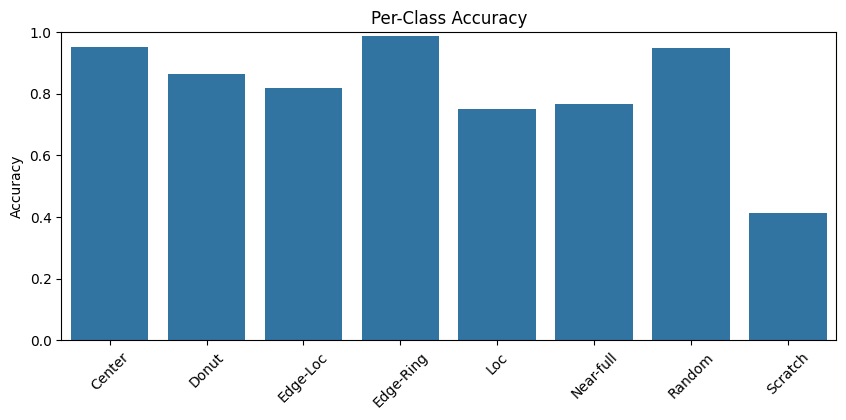

In [88]:
class_acc = cm.diagonal() / cm.sum(axis=1)

plt.figure(figsize=(10,4))
sns.barplot(
    x=le.classes_,
    y=class_acc
)
plt.xticks(rotation=45)
plt.ylabel("Accuracy")
plt.title("Per-Class Accuracy")
plt.ylim(0,1)
plt.show()


In [90]:
model.save("wafer_defect_cnn.keras")


In [92]:
!pip install tf2onnx


INFO: pip is looking at multiple versions of onnx to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.8/455.8 kB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 66.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.1/162.1 kB 9.1 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.5
    Uninstalling protobuf-5.29.5:
      Successfully uninstalled protobuf-5.29.5
  Attempting uninstall: onnx
    Found existing installation: onnx 1.20.1
    Uninstalling onnx-1.20.1:
      Successfully uninstalled onnx-1.20.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-adk 1.22.1 requires google-cloud-bigquery-storage>=2.0.0, which is not installed.
bigframes 2.26.0 requires google-c

In [96]:
model.save("wafer_defect_cnn.keras")


In [97]:
import tensorflow as tf
import tf2onnx
from tensorflow.keras import Model, Input

# reload model safely
model = tf.keras.models.load_model("wafer_defect_cnn.keras")

# wrap with explicit input
inputs = Input(shape=(64, 64, 1), name="input")
outputs = model(inputs)
wrapped_model = Model(inputs, outputs)

spec = (tf.TensorSpec((None, 64, 64, 1), tf.float32, name="input"),)

tf2onnx.convert.from_keras(
    wrapped_model,
    input_signature=spec,
    output_path="wafer_defect_cnn.onnx",
    opset=13
)


I0000 00:00:1770497954.046442     118 devices.cc:67] Number of eligible GPUs (core count >= 8, compute capability >= 0.0): 0
I0000 00:00:1770497954.046841     118 single_machine.cc:374] Starting new session
I0000 00:00:1770497954.204096     118 devices.cc:67] Number of eligible GPUs (core count >= 8, compute capability >= 0.0): 0
I0000 00:00:1770497954.204366     118 single_machine.cc:374] Starting new session
ERROR:tf2onnx.tfonnx:rewriter <function rewrite_constant_fold at 0x7b2cf123a2a0>: exception `np.cast` was removed in the NumPy 2.0 release. Use `np.asarray(arr, dtype=dtype)` instead.


(ir_version: 7
 producer_name: "tf2onnx"
 producer_version: "1.16.1 15c810"
 graph {
   node {
     input: "input"
     input: "new_shape__23"
     output: "functional_19_1/sequential_2_1/conv2d_4_1/BiasAdd__6:0"
     name: "functional_19_1/sequential_2_1/conv2d_4_1/BiasAdd__6"
     op_type: "Reshape"
     domain: ""
   }
   node {
     input: "functional_19_1/sequential_2_1/conv2d_4_1/BiasAdd__6:0"
     input: "functional_19_1/sequential_2_1/conv2d_4_1/convolution/ReadVariableOp:0"
     input: "functional_19_1/sequential_2_1/conv2d_4_1/Squeeze:0"
     output: "functional_19_1/sequential_2_1/conv2d_4_1/BiasAdd:0"
     name: "functional_19_1/sequential_2_1/conv2d_4_1/BiasAdd"
     op_type: "Conv"
     attribute {
       name: "dilations"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "strides"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "kernel_shape"
       ints: 3
       ints: 3
       type: INTS
     }
   

In [98]:
import onnx

onnx_model = onnx.load("wafer_defect_cnn.onnx")
onnx.checker.check_model(onnx_model)
print("ONNX model is valid ✅")


ONNX model is valid ✅
